# **Python IRI Demonstration**
An instructional tool for calculating IRI from road profiles and visualizing the motion of the quarter car model. Written for instructional purposes only. You do not need to know Python to use this tool. Follow instructions and click on the arrow symbol next to each cell to execute said cell. 

IRI is calculated using Sroubek, M. Sorel, J. Zak: Precise International Roughness Index Calculation. Int. J. Pavement Res. Technol. (2021) [github.com/michalsorel](https://github.com/michalsorel/iri). Springs were drawn using
[github.com/nrsyed](https://github.com/nrsyed/utilities/tree/master/spring).

For source code, visit [github/egemenokte](https://github.com/egemenokte)

# Import packages and connect to Github

In [ ]:
!git clone https://github.com/egemenokte/PavementPython.git
%cd PavementPython/IRIPython
from IPython.display import clear_output
clear_output()
print('All good, move to next step')

All good, move to next step


animate function is used to animate the quarter car model at the end

In [ ]:
import python.iri as Rough
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import rc
from IPython.display import HTML
from matplotlib import animation
from matplotlib.animation import FuncAnimation
from matplotlib.patches import Ellipse, Circle, Rectangle
import seaborn as sns
sns.set()
def animateIRI(ZZ,resx=20,usdist=0.15/2,sdist=0.2,frames=500,interval=20):
  '''
  Inputs:
  ZZ -  Location of unsprung and sprung mass, as well as the road profile
  resx - total distance to plot in x (m)
  usdist - unsprung mass distance from road (m)
  sdist - sprung mass distance from road (m)
  frames - number of frames to animate
  interval - time between frames in ms

  Output:
  animation object
  '''
  from matplotlib.animation import FuncAnimation
  from matplotlib.patches import  Rectangle
  plt.close('all')

  # sns.set()
  #save=save
  resx=resx # total x distance of plot  (m)
  usdist=usdist #unsprung mass distance from road (m)
  sdist=sdist # sprung mass distance from road
  distbet=sdist-usdist
  US=ZZ[:,1]+usdist
  S=ZZ[:,0]+sdist
  US=US
  S=S
  X=ZZ[:,2]
  R=ZZ[:,3]
  dif=X[1]-X[0]
  IRIi=ZZ[:,4]
  IRIc=np.cumsum(IRIi)/(np.arange(len(IRIi))+1)
  fig, ax = plt.subplots(figsize=(7,5));

  def animate(i):

      ax.clear()
      Xp=X[max(0,i-int(resx/dif)):i+int(resx/dif)+1]
      Rp=R[max(0,i-int(resx/dif)):i+int(resx/dif)+1]
      ax.fill(np.append(Xp,[max(Xp),min(Xp)]), np.append(Rp,[min(Rp)-0.1,min(Rp)-0.1]),color='dimgray') #draw the road
      x,y=Rough.spring((X[i], R[i]),(X[i], US[i]),8,resx/20) #draw the first spring from road to unsprung
      ax.plot(x,y,color='grey',zorder=1)
      x,y=Rough.spring((X[i]-resx/10*3/5, US[i]),(X[i]-resx/10*3/5, S[i]),10,resx/20) #second spring between masses
      ax.plot(x,y,color='grey',zorder=1)
      
      ax.plot([X[i]+resx/10*3/5, X[i]+resx/10*3/5],[US[i],US[i]+distbet/2],color='grey',zorder=1)
      ax.plot([X[i]+resx/10*3/5-resx/40, X[i]+resx/10*3/5+resx/40],[US[i]+distbet/2,US[i]+distbet/2],color='grey',zorder=1)
      ax.plot([X[i]+resx/10*3/5, X[i]+resx/10*3/5],[S[i],S[i]-distbet/2*0.6],color='grey',zorder=1)
      ax.plot([X[i]+resx/10*3/5-resx/30, X[i]+resx/10*3/5+resx/30],[S[i]-distbet/2*0.6,S[i]-distbet/2*0.6],color='grey',zorder=1)
      ax.plot([X[i]+resx/10*3/5-resx/30, X[i]+resx/10*3/5-resx/30],[S[i]-distbet/2*0.6,S[i]-distbet/2*1.2],color='grey',zorder=1)
      ax.plot([X[i]+resx/10*3/5+resx/30, X[i]+resx/10*3/5+resx/30],[S[i]-distbet/2*0.6,S[i]-distbet/2*1.2],color='grey',zorder=1)
      
      ax.scatter(X[i], R[i],color='black',zorder=2) # draw a ball on the road profile
      ax.plot(X[i-int(resx/dif):i+1], US[i-int(resx/dif):i+1],zorder=1,color='midnightblue') #unsprung mass history
      ax.plot(X[i-int(resx/dif):i+1], S[i-int(resx/dif):i+1],zorder=1,color='darkred') #sprung mass history
      
      ax.add_patch(Rectangle((X[i]-resx/10, US[i]-sdist/20), resx/5, sdist/10,color='midnightblue')) #unsprung mass
      ax.add_patch(Rectangle((X[i]-resx/10, S[i]-sdist/20), resx/5, sdist/10,color='darkred')) #sprung mass
      
      ax.text(X[max(0,i-int(resx/dif))]+sdist/2, R[i]-sdist/2.1, f"IRI Instant. = {np.round(IRIi[i],1)} m/km", size=15, color='Black')
      ax.text(X[max(0,i-int(resx/dif))]+sdist/2, R[i]+sdist*1.5, f"IRI Overall = {np.round(IRIc[i],1)} m/km", size=15, color='Black')


      ax.set_xlim([X[max(0,i-int(resx/dif))],X[i+int(resx/dif)]])
      ax.set_ylim([R[i]-sdist/2,R[i]+sdist*3/2])
      ax.grid(False)

      # Hide axes ticks
      ax.set_xticks([])
      ax.set_yticks([])
      ax.set_xticks([X[max(0,i-int(resx/dif))],X[i+int(resx/dif)]],['',str(2*resx)+'m'])
      # implot = plt.imshow(im,aspect='auto',zorder=0,extent=[X[max(0,i-int(resx/dif))],X[i+int(resx/dif)], R[i]-0.1, R[i]+0.3])

  ani = FuncAnimation(fig, animate, frames=frames, interval=interval, repeat=True,repeat_delay = 300);

  
  plt.close('all')
  return ani
clear_output()
print('All good, move to next step')

All good, move to next step


# Calculating IRI
Read the road profile and analyze IRI. By default, you can choose between Profile_0, Profile_1 and Profile_2. You can also change to code to run your own profile.

Parameter start_pos does not exist, set to the first sample.
IRI computation
----------------------------------------
Regular sampling: 0.25 m
Samples are more than 0.125 m from each other, box filter not needed, skipped...
Segment length: 20 m
Starting position: 478.0 m
Method: 2
Number of segments: 27


<Figure size 640x480 with 0 Axes>

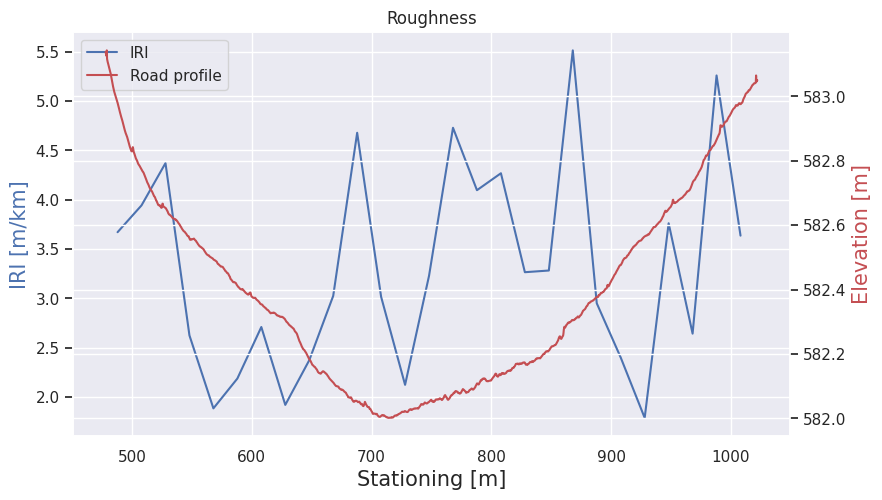

<Figure size 640x480 with 0 Axes>

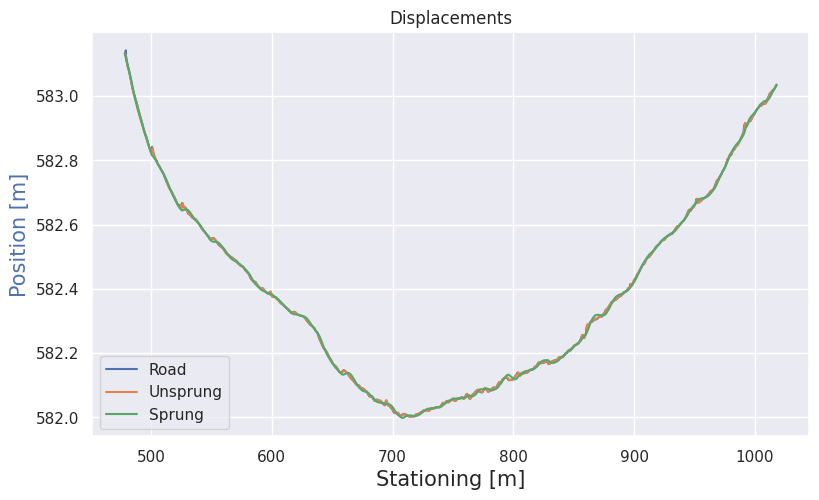

In [ ]:
road_profile=Rough.readxlsx('Profiles/Profile_1.xlsx',stick=0.25) #take 0.25m average (as generally used in IRI calculations)
IRI, equidistant,ZZ = Rough.iri(road_profile, segment_length=20, start_pos=-1, step=0, box_filter = True, method = 2) #segment length (m) to use for IRI calculation
#Plot results
plt.close('all')
plt.figure()
Rough.plot_iri(IRI,road_profile, 'Roughness')
plt.figure()
Rough.plot_mass(ZZ, 'Displacements')

# Animation
Animate the quarter car model. You can see optional parameters where function animateIRI is defined

In [5]:
print('Please wait for animation to be rendered. It can take a while.')
rc('animation', html='jshtml');
ani=animateIRI(ZZ,resx=20,usdist=0.15/2,sdist=0.2,frames=500,interval=30) #Higher the frames, higher the render time!
ani

Please wait for animation to be rendered. It can take a while.
